 # Lab 3: CNN - Convolutional Neural Networks (СNN)

1. Use dataset Caltech101
2. Attach binaries including the following three (3) trained models

  a) Plain 3-layer CNN (1)
  b) Frozen pre-trained ResNet as feature extractor (2)
  c) Fine-tuned pre-trained ResNet (3)


3. Attach train/validation results reported in the following form
  a) sklearn. metrics.classification_report
  b) 101x101 confusion matrices
  c) Learning curves by hand or TensorBoards learning curves
  d) ROC Curve plot
  e) AUC-PRC plot
  f) The top-1 error rate in %


4. Visualize filters and corresponding feature maps of the first and second Conv2d layers
5. Explain the results:
  a) What kind of features did filters extract?
  b) Do you have "blind" filters that didn't learn anything? Why? How could you fix that?
  c) Does your model consider the background of the inputs?
  d) Does your model consider the color of the inputs?
  

Conclusions must be relevant to your specific case and results, not general recommendations from public internet.


In [ ]:
import tensorflow as tf
from tensorflow import keras

print(tf.version.VERSION)

2.18.0


# Prepare Data from Caltech101


## unzip data

In [ ]:
!rm -rf cnn
!mkdir -p cnn

#Zip entpacken in cnn
!unzip caltech-101.zip -d cnn

# Zielordner für die Bilder anlegen
!mkdir -p cnn/101_ObjectCategories

# .tar.gz entpacken, oberste Ordner-Ebene entfernen, Inhalt direkt in cnn/101_ObjectCategories packen
!tar -xzf cnn/caltech-101/101_ObjectCategories.tar.gz -C cnn/101_ObjectCategories --strip-components=1


!rm -rf cnn/images/__**


Archive:  caltech-101.zip
   creating: cnn/caltech-101/
  inflating: cnn/__MACOSX/._caltech-101  
  inflating: cnn/caltech-101/101_ObjectCategories.tar.gz  
  inflating: cnn/__MACOSX/caltech-101/._101_ObjectCategories.tar.gz  
  inflating: cnn/caltech-101/show_annotation.m  
  inflating: cnn/__MACOSX/caltech-101/._show_annotation.m  
  inflating: cnn/caltech-101/Annotations.tar  
  inflating: cnn/__MACOSX/caltech-101/._Annotations.tar  


In [ ]:
import shutil

#Ordner rekursiv löschen (inkl. aller Unterordner/Dateien)
shutil.rmtree('cnn')

In [ ]:
import shutil

#Ordner rekursiv löschen (inkl. aller Unterordner/Dateien)
shutil.rmtree('logs')

In [ ]:
import pathlib
from PIL import Image

data_directory = pathlib.Path('cnn/101_ObjectCategories').with_suffix('')

image_count = len(list(data_directory.glob('**/*.jpg')))
print(f'Images: {image_count}')

images = [Image.open(image) for image in data_directory.glob("*/*")]

Images: 9144


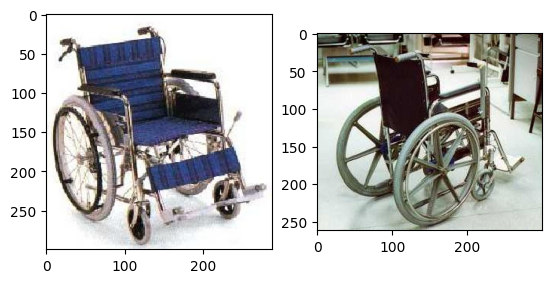

In [ ]:
import matplotlib.pyplot as plt


plt.subplot(1,2,1)

plt.imshow(images[5])
plt.subplot(1,2,2)
plt.imshow(images[4])

plt.show()

In [ ]:
images[4].size
images[5].size

(288, 300)

## Split data in training, validation and test data

In [ ]:
from pickle import NONE
# split data in test and train and validation
#https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image_dataset_from_directory
import tensorflow as tf

dataset = tf.keras.preprocessing.image_dataset_from_directory(
  data_directory,
  labels='inferred',
    label_mode='int',
    class_names=None,
    color_mode='rgb',
    batch_size= None, #needs to be none(!)
    image_size=(250,300),
    shuffle=True,
    seed=42,
    validation_split=None,
    subset=None,
    interpolation='bilinear',
    follow_links=False,
    crop_to_aspect_ratio=False,
    pad_to_aspect_ratio=False,
    data_format=None,
    verbose=True
)

print("classes before shuffle:", dataset.class_names)

#shuffle dataset
#dataset = dataset.shuffle(buffer_size=len(dataset), reshuffle_each_iteration=False)

print(f'Dataset size: {len(dataset)}')
print(f'Classes sizes: {len(dataset.class_names)}')


#training: ca 70/80%
#validation: ca 10-15%
#test: ca 10-15%

train_data_size = int(0.75 * len(dataset))
validation_data_size = int(0.125 * len(dataset))
test_data_size = 9411 - train_data_size - validation_data_size


train_data = dataset.take(train_data_size)
validation_data = dataset.skip(train_data_size).take(validation_data_size)
test_data = dataset.skip(train_data_size + validation_data_size).take(test_data_size)

print(f'Train data size: {len(train_data)}')
print(f'Validation data size: {len(validation_data)}')
print(f'Test data size: {len(test_data)}')


#batchen
train_data = train_data.batch(64)
validation_data = validation_data.batch(64)
test_data = test_data.batch(64)




Found 9144 files belonging to 102 classes.
classes before shuffle: ['BACKGROUND_Google', 'Faces', 'Faces_easy', 'Leopards', 'Motorbikes', 'accordion', 'airplanes', 'anchor', 'ant', 'barrel', 'bass', 'beaver', 'binocular', 'bonsai', 'brain', 'brontosaurus', 'buddha', 'butterfly', 'camera', 'cannon', 'car_side', 'ceiling_fan', 'cellphone', 'chair', 'chandelier', 'cougar_body', 'cougar_face', 'crab', 'crayfish', 'crocodile', 'crocodile_head', 'cup', 'dalmatian', 'dollar_bill', 'dolphin', 'dragonfly', 'electric_guitar', 'elephant', 'emu', 'euphonium', 'ewer', 'ferry', 'flamingo', 'flamingo_head', 'garfield', 'gerenuk', 'gramophone', 'grand_piano', 'hawksbill', 'headphone', 'hedgehog', 'helicopter', 'ibis', 'inline_skate', 'joshua_tree', 'kangaroo', 'ketch', 'lamp', 'laptop', 'llama', 'lobster', 'lotus', 'mandolin', 'mayfly', 'menorah', 'metronome', 'minaret', 'nautilus', 'octopus', 'okapi', 'pagoda', 'panda', 'pigeon', 'pizza', 'platypus', 'pyramid', 'revolver', 'rhino', 'rooster', 'saxoph

## load Tensorboard


In [ ]:
%load_ext tensorboard

In [ ]:
#https://stackoverflow.com/questions/49127214/keras-how-to-output-learning-rate-onto-tensorboard
class LearningRateLogger(tf.keras.callbacks.Callback):
    def __init__(self):
        super().__init__()
        self._supports_tf_logs = True

    def on_epoch_end(self, epoch, logs=None):
        #if logs is None or "learning_rate" in logs:
            #return
        #logs["learning_rate"] = self.model.optimizer.lr

        lr = self.model.optimizer.learning_rate
        if hasattr(lr, 'numpy'):
            lr = lr.numpy()
        logs["learning_rate"] = lr

# 1. Plain 3-Layer CNN

In [ ]:
!rm -r logs/fit1/*

rm: cannot remove 'logs/fit1/*': No such file or directory


In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import datetime
from tensorflow.keras.callbacks import EarlyStopping


def create_plain_three_layer_cnn(input_shape, num_classes):
  model1 = keras.Sequential()

  #1. Conv layer
  model1.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
  model1.add(layers.BatchNormalization())
  model1.add(layers.MaxPooling2D((2, 2)))

  #2. Conv layer
  model1.add(layers.Conv2D(64, (3, 3), activation='relu'))
  model1.add(layers.BatchNormalization())
  model1.add(layers.MaxPooling2D((2, 2)))

  #3. Conv
  model1.add(layers.Conv2D(128, (3, 3), activation='relu', padding='same'))
  model1.add(layers.BatchNormalization())
  model1.add(layers.MaxPooling2D((2, 2)))

  #4. Flatten
  model1.add(layers.Flatten())

  #5. Dense
  model1.add(layers.Dense(128, activation='relu'))

  #6. Output
  model1.add(layers.Dense(num_classes, activation='softmax'))


  return model1

model1 = create_plain_three_layer_cnn(input_shape=(250, 300, 3), num_classes=len(dataset.class_names))

model1.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)


log_dir = "logs/fit1/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
callbacks_list=[tensorboard_callback, early_stopping]



history = model1.fit(
    train_data,
    validation_data=validation_data,
    epochs=40,
    callbacks=callbacks_list)

model1.summary()




/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 57s 394ms/step - accuracy: 0.1769 - loss: 10.6435 - val_accuracy: 0.2275 - val_loss: 4.0024
Epoch 2/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 30s 276ms/step - accuracy: 0.3005 - loss: 3.4962 - val_accuracy: 0.3482 - val_loss: 3.5103
Epoch 3/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 33s 302ms/step - accuracy: 0.3483 - loss: 3.3866 - val_accuracy: 0.3535 - val_loss: 3.5220
Epoch 4/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 30s 274ms/step - accuracy: 0.3591 - loss: 3.2128 - val_accuracy: 0.3193 - val_loss: 3.5753
Epoch 5/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.3588 - loss: 3.2257 - val_accuracy: 0.3430 - val_loss: 3.3426
Epoch 6/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 32s 294ms/step - accuracy: 0.3841 - loss: 3.0319 - val_accuracy: 0.3465 - val_loss: 3.3504
Epoch 7/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 33s 302ms/step - accuracy: 0.3979 - loss: 2.9676 - val_accuracy: 0.3902 - val_loss: 3.1339
Epoch 8/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 30s 275ms/step - accuracy: 0.3982 - loss: 

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 248, 298, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 248, 298, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 124, 149, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 122, 147, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 122, 147, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 61, 73, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 61, 73, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 61, 73, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 30, 36, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 138240)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │    17,694,848 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 102)            │        13,158 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 53,405,556 (203.73 MB)

 Trainable params: 17,801,702 (67.91 MB)

 Non-trainable params: 448 (1.75 KB)

 Optimizer params: 35,603,406 (135.82 MB)

## Results from Plain 3 Layer CNN

### 1. Classification Report

In [ ]:
from sklearn.metrics import classification_report
#https://scikit-learn.org/stable/modules/generated/sklearn.metrics.classification_report.html
import numpy as np

y_true = []
y_pred = []

for images, labels in test_data:
    preds = model1.predict(images)
    preds_classes = np.argmax(preds, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(preds_classes)


print(classification_report(y_true, y_pred, target_names=dataset.class_names))

2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
                   precision    recall  f1-score   support

BACKGROUND_Google       0.08      0.95      0.15        55
            Faces       0.70      0.97      0.81        59
       Faces_easy       1.00      0.93      0.97        46
         Leopards       0.94      1.00      0.97        17
       Motorbikes     

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


#### just to see how many pictures each category has

In [ ]:
import pathlib

# Pfad zu deinem Dataset-Ordner
data_directory = pathlib.Path('cnn/101_ObjectCategories')

# Dict für Bildanzahl pro Kategorie
category_image_counts = {}

# Für jeden Unterordner (Kategorie)
for category_dir in data_directory.iterdir():
    if category_dir.is_dir():
        # Zähle alle .jpg Dateien in diesem Ordner
        image_count = len(list(category_dir.glob('*.jpg')))
        category_image_counts[category_dir.name] = image_count

# Ausgabe
for category, count in category_image_counts.items():
    print(f'{category}: {count} Pictures')

# Gesamtanzahl Bilder im Dataset
total_images = sum(category_image_counts.values())
print(f'\nGesamtanzahl Bilder: {total_images}')


wheelchair: 59 Pictures
scissors: 39 Pictures
Leopards: 200 Pictures
ewer: 85 Pictures
electric_guitar: 75 Pictures
emu: 53 Pictures
Faces: 435 Pictures
bonsai: 128 Pictures
ibis: 80 Pictures
laptop: 81 Pictures
water_lilly: 37 Pictures
grand_piano: 99 Pictures
cellphone: 59 Pictures
beaver: 46 Pictures
umbrella: 75 Pictures
anchor: 42 Pictures
okapi: 39 Pictures
sunflower: 85 Pictures
barrel: 47 Pictures
sea_horse: 57 Pictures
panda: 38 Pictures
helicopter: 88 Pictures
stop_sign: 64 Pictures
nautilus: 55 Pictures
ketch: 114 Pictures
pyramid: 57 Pictures
cannon: 43 Pictures
lobster: 41 Pictures
cougar_body: 47 Pictures
garfield: 34 Pictures
car_side: 123 Pictures
gramophone: 51 Pictures
metronome: 32 Pictures
rhino: 59 Pictures
schooner: 63 Pictures
minaret: 76 Pictures
euphonium: 64 Pictures
crab: 73 Pictures
revolver: 82 Pictures
flamingo_head: 45 Pictures
binocular: 33 Pictures
soccer_ball: 64 Pictures
yin_yang: 60 Pictures
kangaroo: 86 Pictures
pagoda: 47 Pictures
snoopy: 35 Pictur

### 2. 101 x 101 Confusion Matrix

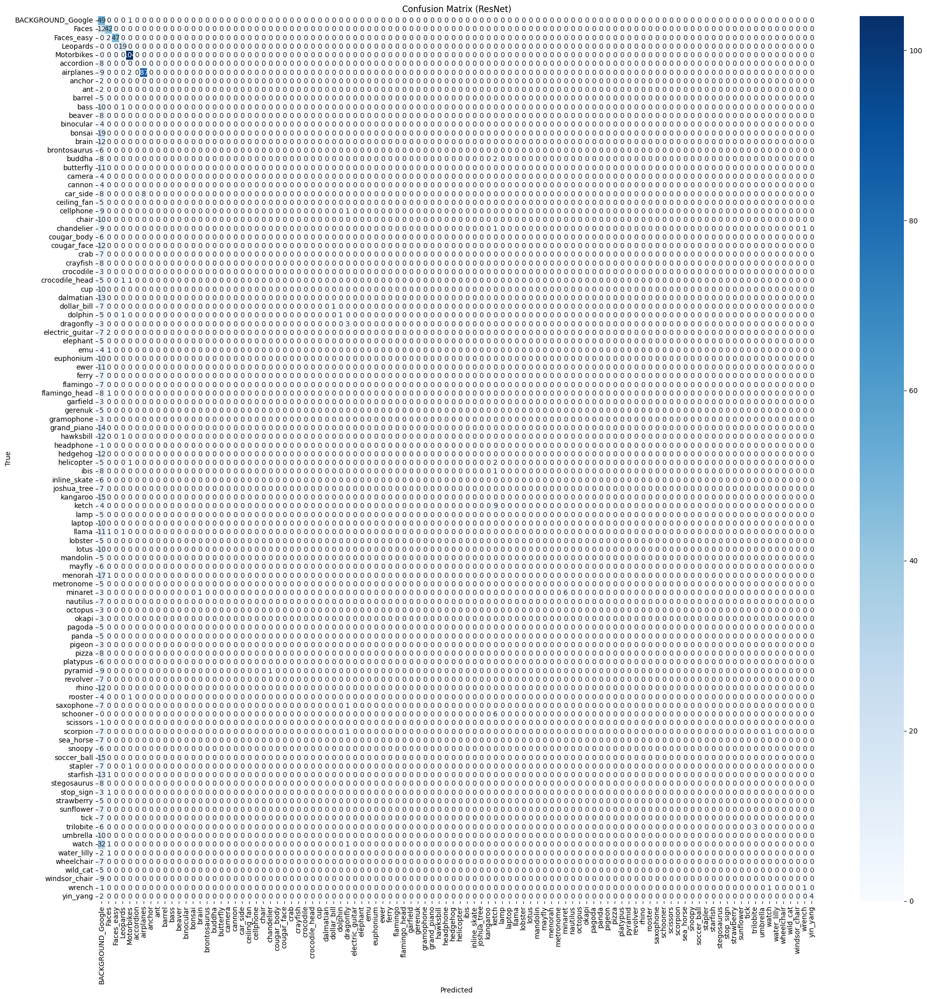

In [ ]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

#https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html
#Vorhersagen und wahre Labels sammeln
y_true = []
y_pred = []

for images, labels in test_data:
    preds = model1.predict(images, verbose=0)
    preds_classes = np.argmax(preds, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(preds_classes)

#  Confusion Matrix berechnen
cm = confusion_matrix(y_true, y_pred)

# Visualisierung mit seaborn
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=dataset.class_names,
            yticklabels=dataset.class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix (ResNet)')
plt.tight_layout()
plt.show()


### 3. Tensor Board Learning curve

In [ ]:
%tensorboard --logdir logs/fit1

<IPython.core.display.Javascript object>

#### Pictures

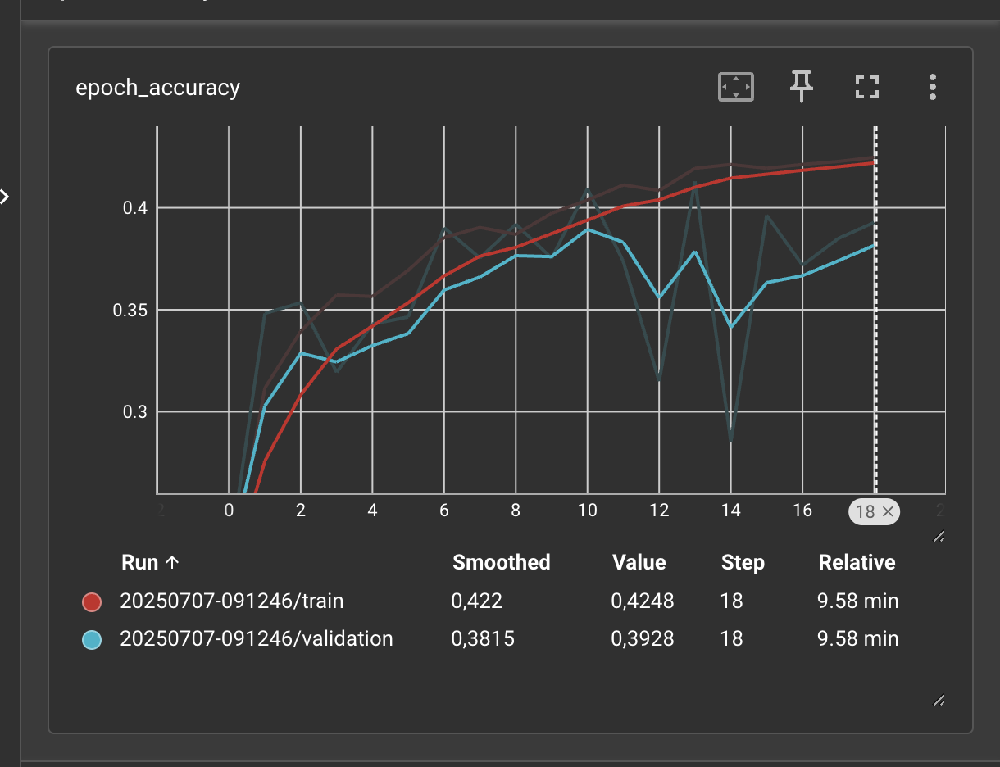

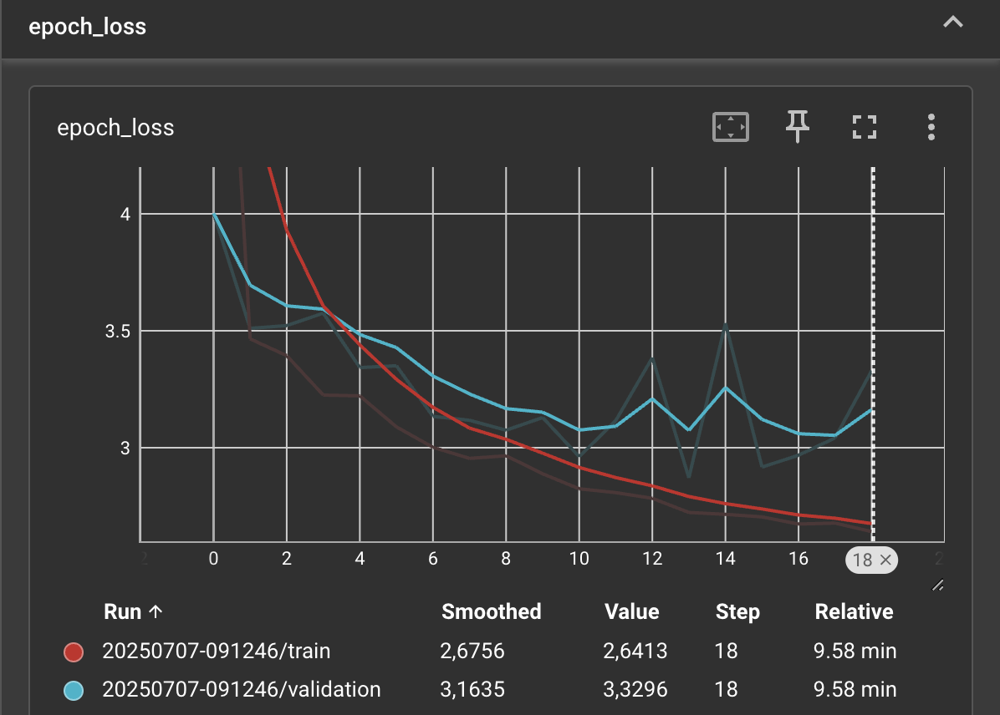

### 4. ROC Curve

In [ ]:
!pip install -U scikit-plot
!pip install scipy==1.10.1


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


/tmp/ipython-input-13-1343722739.py:28: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', n_classes)  # bis zu 20 Farben


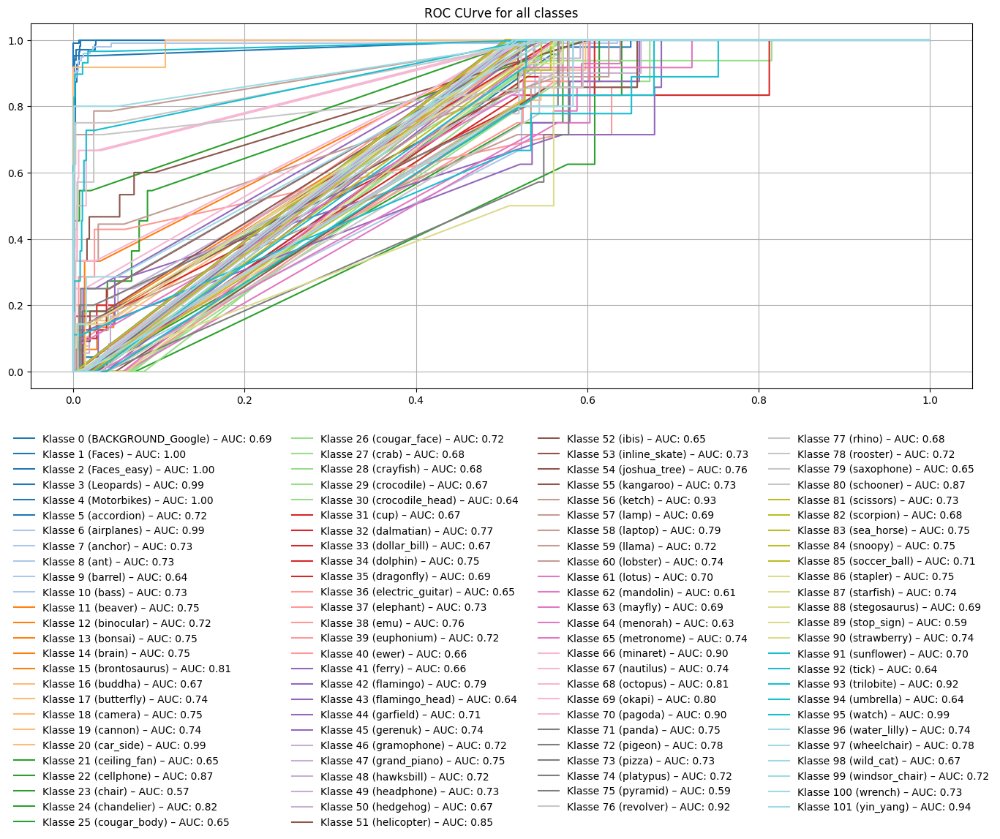

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc

#Labels und vorhergesagte Wahrscheinlichkeiten sammeln

y_true = []
y_proba = []

for images, labels in test_data:
    probs = model1.predict(images)
    y_proba.append(probs)
    y_true.extend(labels.numpy())

y_true = np.array(y_true)
y_pred_proba = np.vstack(y_proba)

n_classes = y_pred_proba.shape[1]
y_true_bin = label_binarize(y_true, classes=np.arange(n_classes))

plt.figure(figsize=(15, 12))
colors = plt.cm.get_cmap('tab20', n_classes)  #bis zu 20 Farben

for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_pred_proba[:, i])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'Klasse {i} ({dataset.class_names[i]}) – AUC: {roc_auc:.2f}', color=colors(i))



plt.legend(loc='upper center',
           bbox_to_anchor=(0.5, -0.1),
           ncol=4,
           frameon=False)

plt.grid(True)
plt.title("ROC CUrve for all classes")
plt.tight_layout()
plt.show()



### 5. AUC - PCR Curve


18/18 ━━━━━━━━━━━━━━━━━━━━ 14s 279ms/step


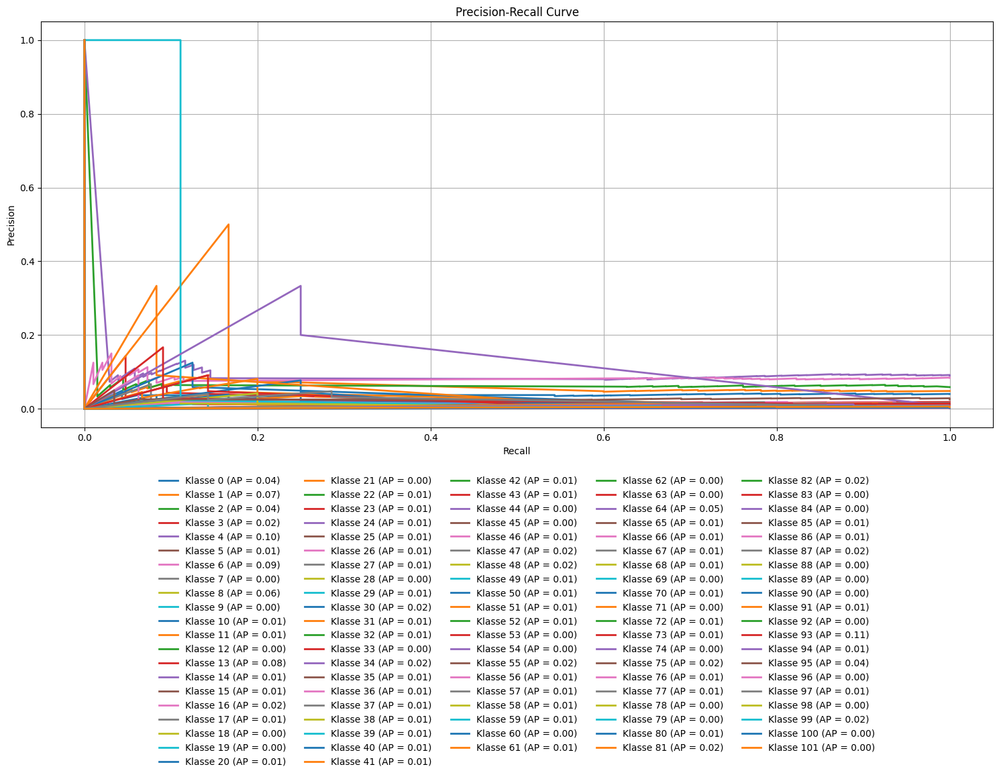

In [ ]:
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt

from sklearn.metrics import precision_recall_curve

import matplotlib.pyplot as plt

# src: https://stackoverflow.com/questions/56090541/how-to-plot-precision-and-recall-of-multiclass-classifier


#auc pcr curve für 3 layer cnn

y_score = model1.predict(test_data)

#Labels aus dem test_data Dataset extrahieren
y_test = np.concatenate([y.numpy() for x, y in test_data], axis=0)

#Labels binarisieren (One-vs-Rest) für Multiklassen-PR-Kurve
n_classes = len(dataset.class_names)
y_test_bin = label_binarize(y_test, classes=list(range(n_classes)))

precision = dict()
recall = dict()
average_precision = dict()

plt.figure(figsize=(15, 12))
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_true_bin[:, i], y_score[:, i])
    ap_score = average_precision_score(y_test_bin[:, i], y_score[:, i])
    plt.plot(recall[i], precision[i], lw=2, label=f'Klasse {i} (AP = {ap_score:.2f})')


plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
# Legende unter dem Diagramm
plt.legend(loc='upper center',
           bbox_to_anchor=(0.5, -0.1),
           ncol=5,
           frameon=False)
plt.grid(True)
plt.tight_layout()
plt.show()


### 6. The top-1 error rate in %

In [ ]:

from sklearn.metrics import top_k_accuracy_score

#Labels und Vorhersagewahrscheinlichkeiten sammeln
y_true = []
y_score = []

for images, labels in test_data:
    probs = model1.predict(images)
    y_score.extend(probs)
    y_true.extend(labels.numpy())

y_true = np.array(y_true)
y_score = np.array(y_score)

# Top-1 Accuracy
top1_acc = top_k_accuracy_score(y_true, y_score, k=1)

# Top-1 Error Rate
top1_error = 1 - top1_acc

print(f"Top-1 Accuracy: {top1_acc * 100:.2f}%")
print(f"Top-1 Error Rate: {top1_error * 100:.2f}%")

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Top-1 Accuracy: 38.06%
Top-1 Error Rate: 61.94%


## Visualize filters and corresponding feature maps of the first and second Conv2d layers

#### Filter

In [ ]:
from matplotlib import pyplot
from keras.models import Model
from keras.layers import Input
from keras.layers import Conv2D


for layer in model1.layers:

  if isinstance(layer, Conv2D):
      weights = layer.get_weights()
      if weights:
        filters, bias = weights
        print(layer.name, filters.shape)

conv2d (3, 3, 3, 32)
conv2d_1 (3, 3, 32, 64)
conv2d_2 (3, 3, 64, 128)



Layer 1: conv2d - Filterform: (3, 3, 3, 32)


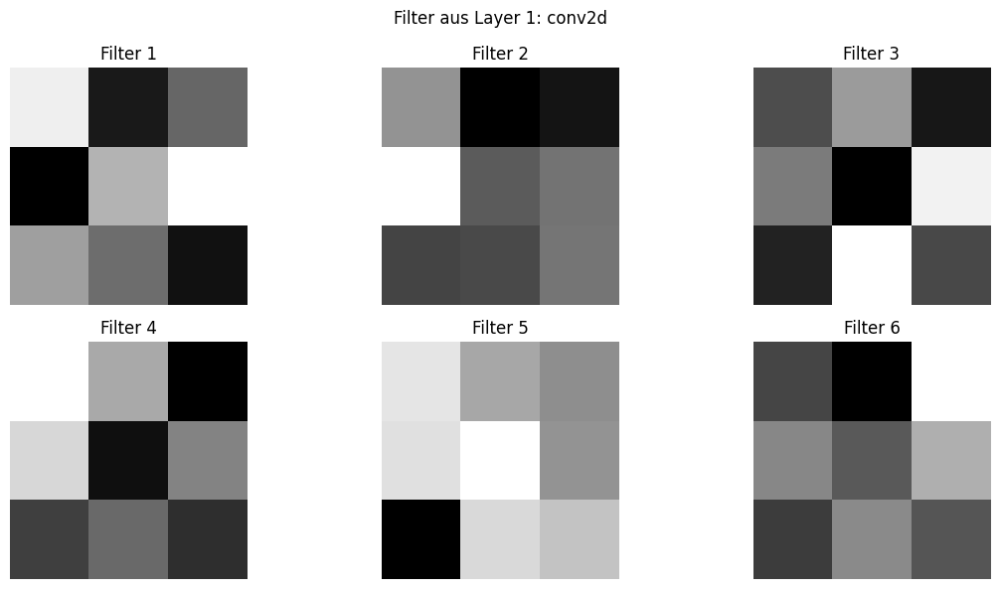


Layer 2: conv2d_1 - Filterform: (3, 3, 32, 64)


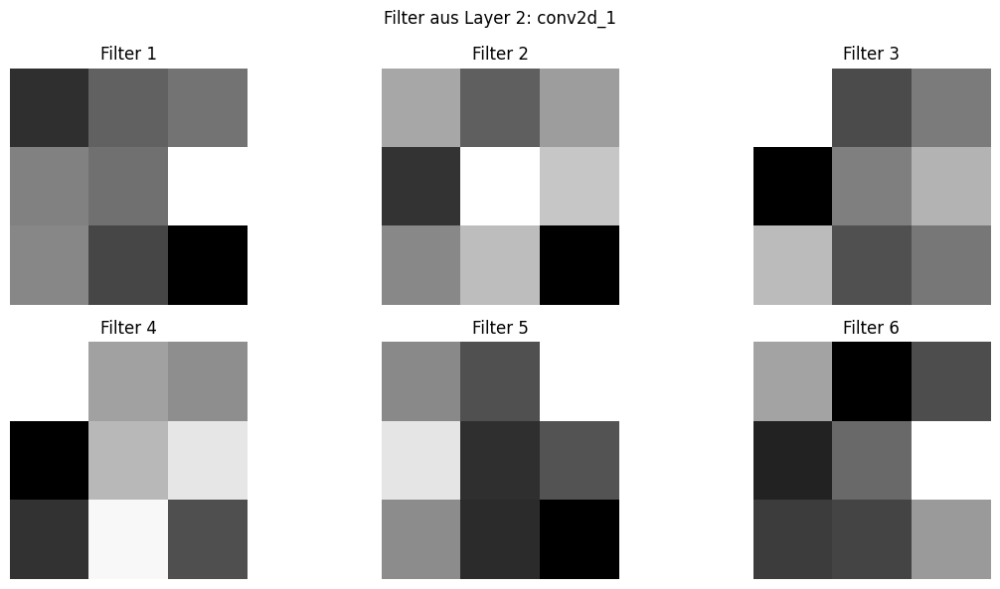

In [ ]:
from matplotlib import pyplot as plt
from tensorflow.keras.layers import Conv2D

#Alle Conv2D-Schichten aus dem Modell holen
conv_layers = []
for layer in model1.layers:
    if isinstance(layer, Conv2D):
        conv_layers.append(layer)

#ersten beiden Conv-Schichten nehmen
for i in range(2):
    layer = conv_layers[i]
    weights = layer.get_weights()

    if len(weights) == 2:  #nur wenn die Schicht Gewichte hat
        filters, biases = weights

        f_min, f_max = filters.min(), filters.max()
        filters = (filters - f_min) / (f_max - f_min)

        print(f"\nLayer {i+1}: {layer.name} - Filterform: {filters.shape}")

        #paar Filter anzeigen (6)
        num_filters = 6
        plt.figure(figsize=(12, 6))

        for j in range(num_filters):
            f = filters[:, :, :, j]
            plt.subplot(2, 3, j + 1)  #2 Reihen, 3 Spalten
            plt.imshow(f[:, :, 0], cmap='gray')
            plt.title(f'Filter {j+1}')
            plt.axis('off')

        plt.suptitle(f'Filter aus Layer {i+1}: {layer.name}')
        plt.tight_layout()
        plt.show()


#### maps

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step


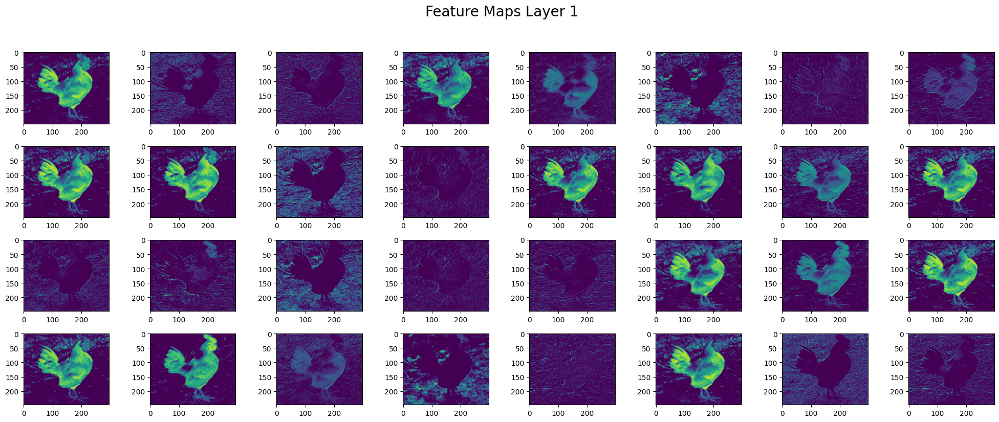

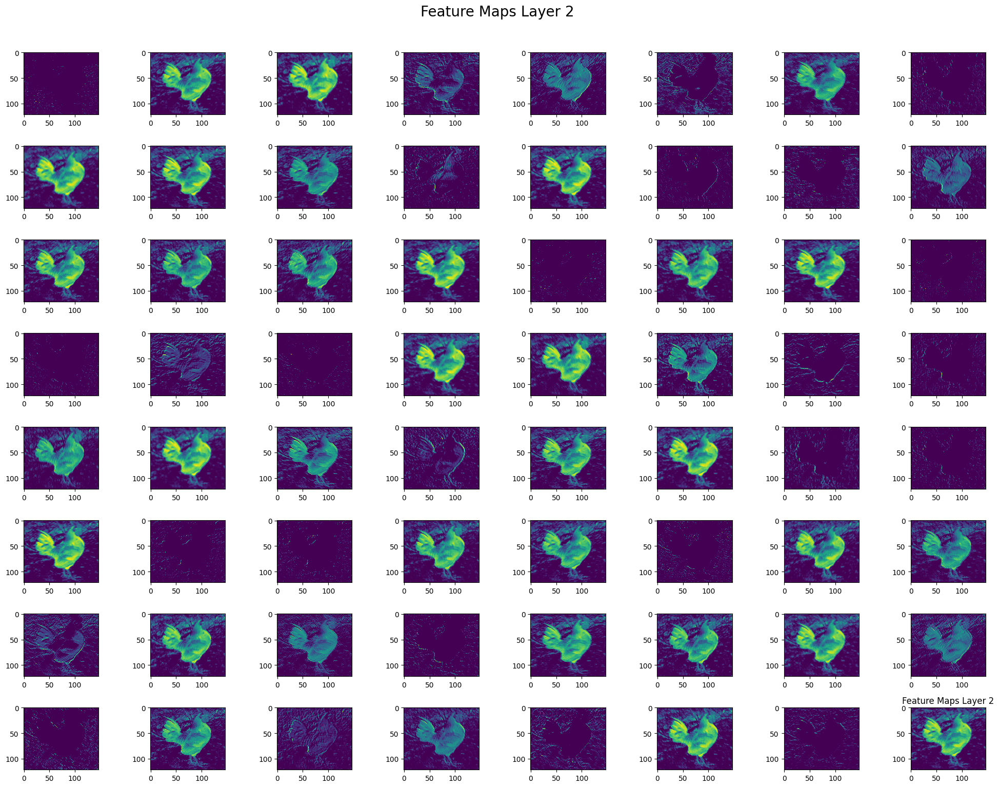

In [ ]:
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from numpy import expand_dims


#https://www.kaggle.com/code/arpitjain007/guide-to-visualize-filters-and-feature-maps-in-cnn

image = images[30]
#convert the image to an array
image = img_to_array(image)
# expand dimensions so that it represents a single 'sample'
image = expand_dims(image, axis=0)
image = preprocess_input(image.copy())

#ersten zwei Conv2D-Schichten im Modell finden
conv_layers = [layer for layer in model1.layers if 'conv' in layer.name]

#Modelle bauen, die Feature-Maps der ersten bzw. zweiten Conv2D-Schicht ausgeben
model_layer1 = Model(inputs=model1.inputs, outputs=conv_layers[0].output)
model_layer2 = Model(inputs=model1.inputs, outputs=conv_layers[1].output)

#calculating features_map
features1 = model_layer1.predict(image)
features2 = model_layer2.predict(image)

#Feature Maps Layer 1
fig1 = pyplot.figure(figsize=(20,15))
fig1.suptitle('Feature Maps Layer 1', fontsize=20, y=1.02)


for i in range(1,features1.shape[3]+1):
    pyplot.subplot(8,8,i)
    pyplot.imshow(features1[0,:,:,i-1] , cmap='viridis')

pyplot.tight_layout()
pyplot.show()


#Feature Maps Layer 2
fig2 = pyplot.figure(figsize=(20,15))
fig2.suptitle('Feature Maps Layer 2', fontsize=20, y=1.02)

for i in range(1,features2.shape[3]+1):
    pyplot.subplot(8,8,i)
    pyplot.imshow(features2[0,:,:,i-1] , cmap='viridis')
pyplot.title('Feature Maps Layer 2')

pyplot.tight_layout()
pyplot.show()






## Questions


Explain the results:
What kind of features did filters extract?
Do you have "blind" filters that didn't learn anything? Why? How could you fix that?
Does your model consider the background of the inputs?
Does your model consider the color of the inputs?


##### What kind of features did filters extract?

**first layer**
* mostly Edge detectors (diagonal lines)
* or contours
* maybe tecture patterns

**second layer**
* also combined features from the first layer
* shape of the chicken
* more complex texture (maybe feathers)



#### Do you have blind filters that didnt learn anythin?




*   no i dont think so:
*   some of the feature maps are dark but not completly black
* maybe they are just so dark to specify some small features



#### Does your model consider the background of the inputs?


*   yes they do, because:
*   to detect the chicken's silhouette, the model must recognize the contrast between the foreground object and the background
* show how strong activation only on the background, meaning some filters have specialized in learning the background's texture



#### Does your model consider the color of the inputs?


*   model's input_shape ends in 3, meaning it processes all three RGB color channels




# 2. Frozen pre-trained ResNet as feature extractor (2)

In [ ]:
!rm -r logs/fit2/*

rm: cannot remove 'logs/fit2/*': No such file or directory


In [ ]:
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
import tensorflow as tf



def create_restnet_extract_model(input_shape_model, num_classes_model):


    base_model = ResNet50(
        include_top=False,
        weights='imagenet',     #Lädt die auf ImageNet trainierten Gewichte
        input_shape=input_shape_model
    )

    #Gewichte von Basismodells einfrieren (Feature Extractor)
    base_model.trainable = False

    model_resnet = keras.Sequential(name="ResNet50_FeatureExtractor")

    #Basismodell als erste "Schicht"
    model_resnet.add(base_model)

    #Schichten für den Klassifikationskopf hinzu
    model_resnet.add(layers.GlobalAveragePooling2D(name="avg_pool"))
    model_resnet.add(layers.Dropout(0.5, name="dropout_top"))
    model_resnet.add(layers.Dense(256, activation='relu', name="dense_hidden"))
    model_resnet.add(layers.Dense(num_classes_model, name="output_logits"))

    return model_resnet, base_model

input_shape_for_model = (250, 300, 3)
model_resnet, resnet_base = create_restnet_extract_model(input_shape_for_model, 102)
model_resnet.summary()

#Callbacks
early_stopping2 = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model_resnet.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

#for tensorboard
log_dir = "logs/fit2/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback2 = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

callbacks_list2 = [early_stopping2, tensorboard_callback2 ]

model_resnet.fit( train_data,
        epochs=40,
        validation_data=validation_data,
        callbacks=callbacks_list2
    )



94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "ResNet50_FeatureExtractor"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 8, 10, 2048)    │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ avg_pool                        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_top (Dropout)           │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_hidden (Dense)            │ (None, 256)            │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ output_logits (Dense)           │ (None, 102)            │        26,214 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 24,138,470 (92.08 MB)

 Trainable params: 550,758 (2.10 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

Epoch 1/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 86s 615ms/step - accuracy: 0.4260 - loss: 2.8013 - val_accuracy: 0.8443 - val_loss: 0.5866
Epoch 2/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 49s 451ms/step - accuracy: 0.8211 - loss: 0.6428 - val_accuracy: 0.8889 - val_loss: 0.3884
Epoch 3/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 80s 432ms/step - accuracy: 0.8978 - loss: 0.3617 - val_accuracy: 0.9125 - val_loss: 0.3007
Epoch 4/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 57s 532ms/step - accuracy: 0.9138 - loss: 0.2808 - val_accuracy: 0.9108 - val_loss: 0.2989
Epoch 5/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 49s 451ms/step - accuracy: 0.9300 - loss: 0.2403 - val_accuracy: 0.9309 - val_loss: 0.2920
Epoch 6/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 47s 440ms/step - accuracy: 0.9383 - loss: 0.2038 - val_accuracy: 0.9405 - val_loss: 0.2436
Epoch 7/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 81s 432ms/step - accuracy: 0.9493 - loss: 0.1578 - val_accuracy: 0.9353 - val_loss: 0.2300
Epoch 8/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 48s 444ms/step - accuracy: 0.9584 - loss: 0

## Results frozen pretrained Resnet feature extractor


### Classification report - resnet50

In [ ]:
from sklearn.metrics import classification_report
import numpy as np


y_true = []
y_pred = []

for images, labels in test_data:
    preds = model_resnet.predict(images)
    preds_classes = np.argmax(preds, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(preds_classes)


print(classification_report(y_true, y_pred, target_names=dataset.class_names))



2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
                   precision    recall  f1-score   support

BACKGROUND_Google       0.85      0.87      0.86        60
            Faces       1.00      1.00      1.00        46
       Faces_easy       0.98      1.00      0.99        57
         Leopards       1.00      1.00      1.00        15
     

### Tensorboard Learning curve resnet

In [ ]:
%tensorboard --logdir logs/fit2

<IPython.core.display.Javascript object>

#### pictures

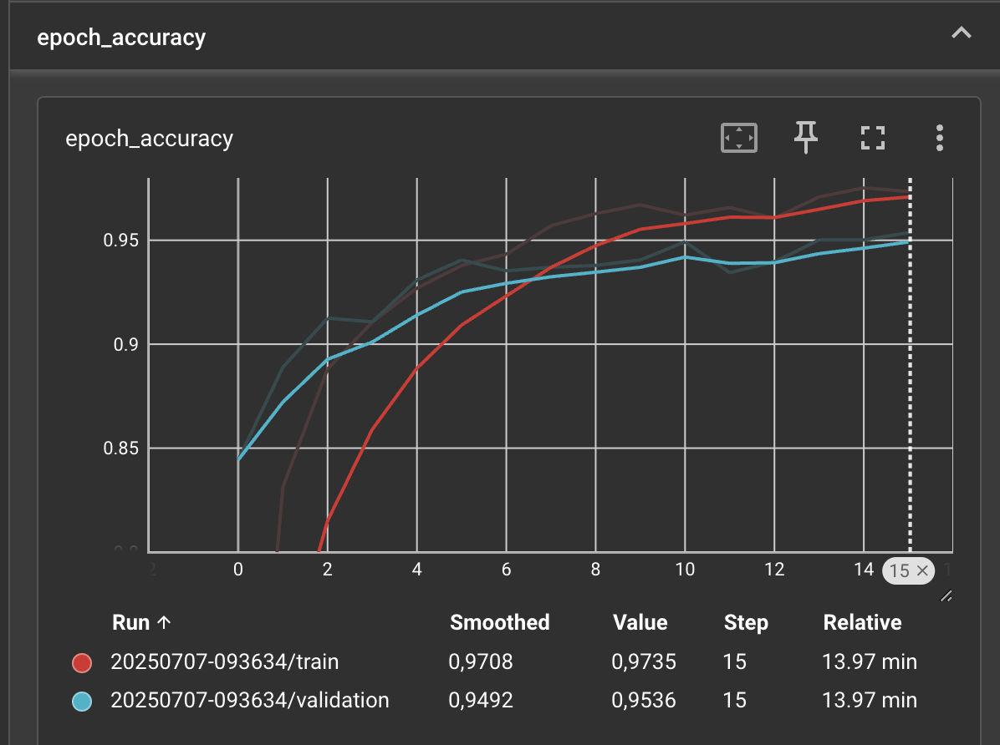

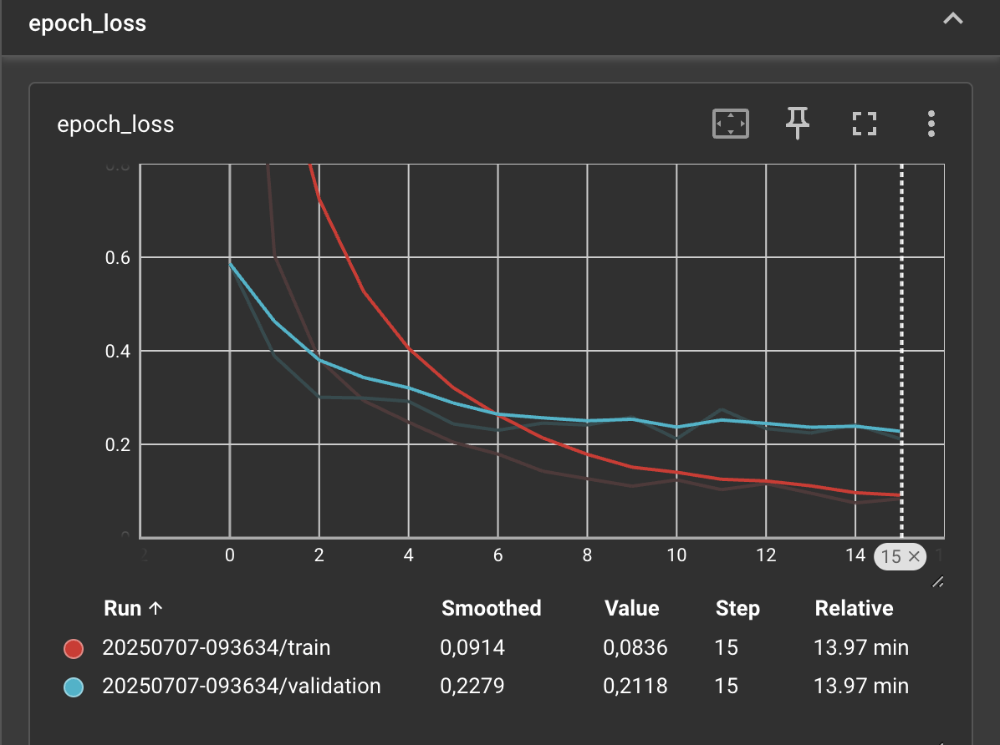

### 101 x 101 Confusion Matrix

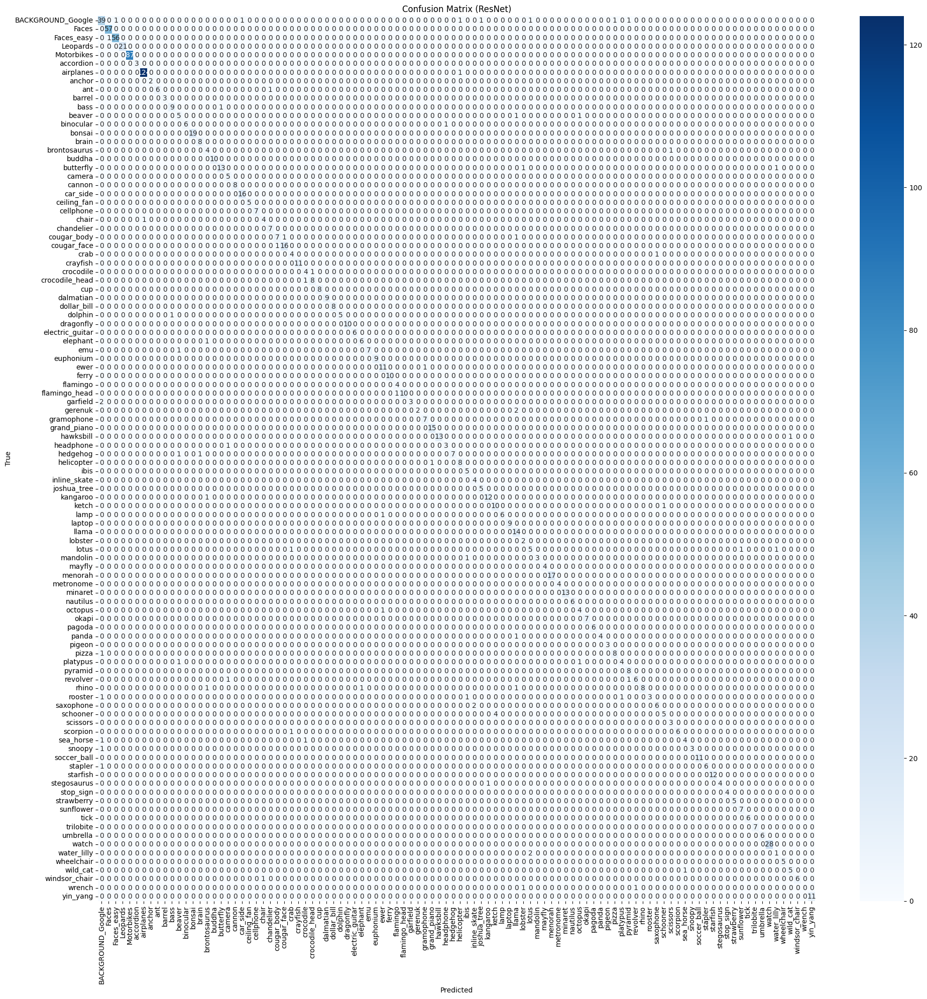

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import numpy as np

# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html

# 1. Vorhersagen und wahre Labels sammeln
y_true = []
y_pred = []

for images, labels in test_data:
    preds = model_resnet.predict(images, verbose=0)
    preds_classes = np.argmax(preds, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(preds_classes)

# 2. Confusion Matrix berechnen
cm = confusion_matrix(y_true, y_pred)

# 3. Visualisierung mit seaborn
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=dataset.class_names,
            yticklabels=dataset.class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix (ResNet)')
plt.tight_layout()
plt.show()

### ROC PLOT

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


/tmp/ipython-input-33-2436264776.py:24: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', n_classes)  # bis zu 20 Farben


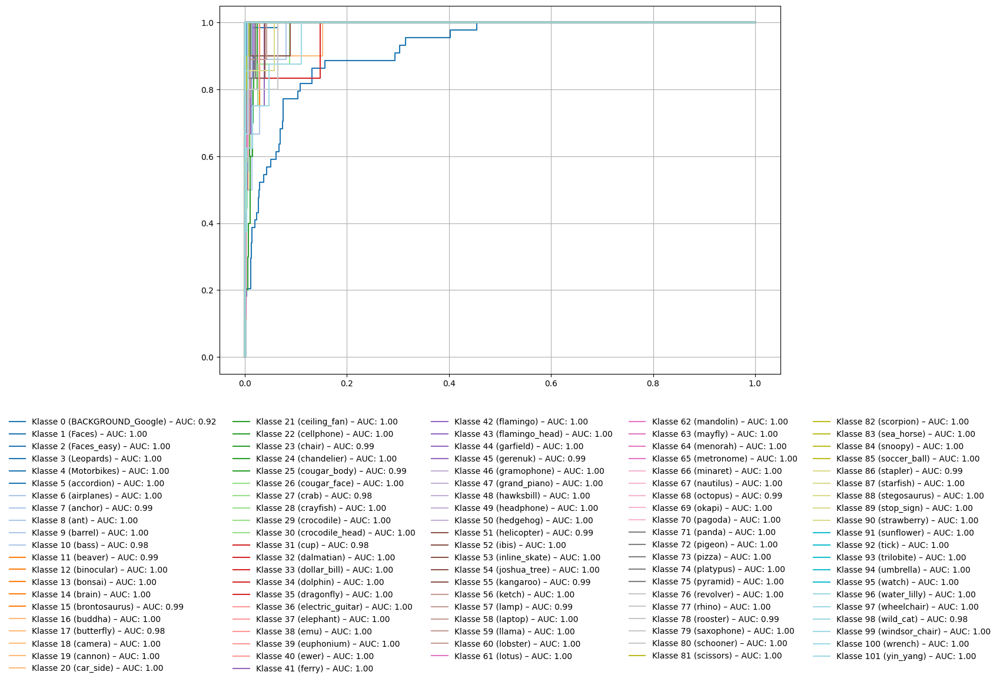

In [ ]:
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc

#Labels und vorhergesagte Wahrscheinlichkeiten sammeln

y_true = []
y_proba = []

for images, labels in test_data:
    probs = model_resnet.predict(images)
    y_proba.append(probs)
    y_true.extend(labels.numpy())

y_true = np.array(y_true)
y_pred_proba = np.vstack(y_proba)

#One-hot-encode die wahren Labels
n_classes = y_pred_proba.shape[1]
y_true_bin = label_binarize(y_true, classes=np.arange(n_classes))

#Plot ROC für jede Klasse
plt.figure(figsize=(15, 12))
colors = plt.cm.get_cmap('tab20', n_classes)  # bis zu 20 Farben

for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_pred_proba[:, i])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'Klasse {i} ({dataset.class_names[i]}) – AUC: {roc_auc:.2f}', color=colors(i))

#Legende unterhalb des Plots
plt.legend(loc='upper center',
           bbox_to_anchor=(0.5, -0.1),
           ncol=5,
           frameon=False)

plt.grid(True)
plt.tight_layout()
plt.show()

### PRC PLOT


18/18 ━━━━━━━━━━━━━━━━━━━━ 12s 266ms/step


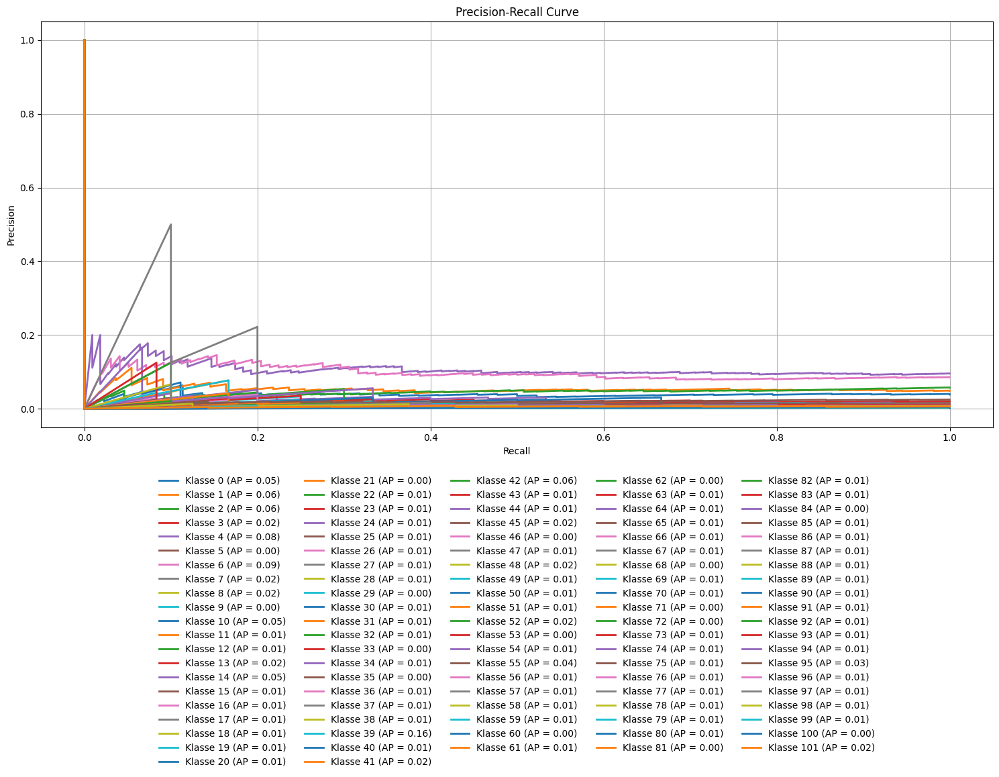

In [ ]:
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt

from sklearn.metrics import precision_recall_curve

import matplotlib.pyplot as plt

# src: https://stackoverflow.com/questions/56090541/how-to-plot-precision-and-recall-of-multiclass-classifier


#auc pcr curve für 3 layer cnn

#Vorhersagen vom Modell für den Testdatensatz holen (test_data ist tf.data.Dataset mit Batches)
y_score = model_resnet.predict(test_data)

#Labels aus dem test_data Dataset extrahieren
y_test = np.concatenate([y.numpy() for x, y in test_data], axis=0)

#Labels binarisieren (One-vs-Rest) für Multiklassen-PR-Kurve
n_classes = len(dataset.class_names)
y_test_bin = label_binarize(y_test, classes=list(range(n_classes)))

precision = dict()
recall = dict()
average_precision = dict()

plt.figure(figsize=(15, 12))
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_true_bin[:, i], y_score[:, i])
    ap_score = average_precision_score(y_test_bin[:, i], y_score[:, i])
    plt.plot(recall[i], precision[i], lw=2, label=f'Klasse {i} (AP = {ap_score:.2f})')


plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
# Legende unter dem Diagramm
plt.legend(loc='upper center',
           bbox_to_anchor=(0.5, -0.1),
           ncol=5,
           frameon=False)
plt.grid(True)
plt.tight_layout()
plt.show()


### Top-1 error rate in %

In [ ]:
from sklearn.metrics import top_k_accuracy_score

# Wahre Labels und Vorhersagewahrscheinlichkeiten sammeln
y_true = []
y_score = []

for images, labels in test_data:
    probs = model_resnet.predict(images)
    y_score.extend(probs)
    y_true.extend(labels.numpy())

y_true = np.array(y_true)
y_score = np.array(y_score)

# Top-1 Accuracy
top1_acc = top_k_accuracy_score(y_true, y_score, k=1)

# Top-1 Error Rate
top1_error = 1 - top1_acc

print(f"Top-1 Accuracy: {top1_acc * 100:.2f}%")
print(f"Top-1 Error Rate: {top1_error * 100:.2f}%")



2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
Top-1 Accuracy: 93.53%
Top-1 Error Rate: 6.47%


# 3. Fine-tuned pre-trained ResNet (3)

In [ ]:
!rm -r logs/fit3/*

rm: cannot remove 'logs/fit3/*': No such file or directory


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, callbacks
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Sequential
import datetime
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import RandomFlip, RandomRotation, RandomZoom

def create_finetuned_pretrained_resnet_model(input_shape,num_classes):

  base_model = ResNet50(
        weights='imagenet',
        include_top=False,
        input_shape=input_shape
    )


  #fFeature Extraction (Freeze Base Model)
  base_model.trainable = False


  model_finetuned_pretrained_resnet = Sequential([
        base_model,
        layers.GlobalAveragePooling2D(name="avg_pool"),
        layers.Dropout(0.5, name="dropout"),
        layers.Dense(256, activation='relu', name="dense_1"),
        layers.Dense(num_classes, activation='softmax', name="predictions")
    ], name="ResNet50_TransferLearning")


  return model_finetuned_pretrained_resnet, base_model


input_shape = (250, 300, 3)
num_classes = 102

#modell wird hier erstellt
model_finetuned_pretrained_resnet, base_model = create_finetuned_pretrained_resnet_model(input_shape, num_classes)

#callbacks für die erste phase
early_stopping3 = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
#for tensorboard
log_dir = "logs/fit3/phase1" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
callbacks_list3 = [early_stopping3, tensorboard_callback ]

#phase 1: wird nur neue dense lsyer trainiert
model_finetuned_pretrained_resnet.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

model_finetuned_pretrained_resnet.fit(train_data,
        epochs=20,
        validation_data=validation_data,
        callbacks=callbacks_list3
    )

model_finetuned_pretrained_resnet.summary()

#phase2: finetuning
base_model.trainable = True


fine_tune_at = 140 #letzten layers werden trainiert

for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False


#compile
model_finetuned_pretrained_resnet.compile(optimizer=tf.keras.optimizers.Adam(1e-5),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

#callbacks für die zweiten phase
early_stopping_4 = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
log_dir = "logs/fit3/phase2" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback2 = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)
callbacks_list_4 = [early_stopping_4, tensorboard_callback2]

model_finetuned_pretrained_resnet.fit(
    train_data,
      initial_epoch=len(model_finetuned_pretrained_resnet.history.epoch),
        epochs=40,
        validation_data=validation_data,
        callbacks=callbacks_list_4
    )

model_finetuned_pretrained_resnet.summary()









94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 85s 607ms/step - accuracy: 0.4244 - loss: 2.7640 - val_accuracy: 0.8460 - val_loss: 0.5675
Epoch 2/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 48s 446ms/step - accuracy: 0.8316 - loss: 0.6312 - val_accuracy: 0.9029 - val_loss: 0.3684
Epoch 3/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 79s 421ms/step - accuracy: 0.8842 - loss: 0.4023 - val_accuracy: 0.9108 - val_loss: 0.3207
Epoch 4/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 80s 406ms/step - accuracy: 0.9067 - loss: 0.2905 - val_accuracy: 0.9344 - val_loss: 0.2275
Epoch 5/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 45s 421ms/step - accuracy: 0.9251 - loss: 0.2319 - val_accuracy: 0.9230 - val_loss: 0.3020
Epoch 6/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 46s 423ms/step - accuracy: 0.9431 - loss: 0.1770 - val_accuracy: 0.9423 - val_loss: 0.2443
Epoch 7/20
108/108 ━━━━━━━━━━━━━━━━━━━━ 44s 409ms/step - accuracy: 0.9363 - loss: 0.1818 - val_accuracy: 0.9405 - val_loss: 0.2413
Epoch 8/20
108/108 ━━━━━━━━━━━━━

Model: "ResNet50_TransferLearning"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 8, 10, 2048)    │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ avg_pool                        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ predictions (Dense)             │ (None, 102)            │        26,214 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 25,239,988 (96.28 MB)

 Trainable params: 550,758 (2.10 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

 Optimizer params: 1,101,518 (4.20 MB)

Epoch 15/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 101s 709ms/step - accuracy: 0.9278 - loss: 0.2320 - val_accuracy: 0.9405 - val_loss: 0.2345
Epoch 16/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 111s 530ms/step - accuracy: 0.9725 - loss: 0.0840 - val_accuracy: 0.9563 - val_loss: 0.1871
Epoch 17/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 56s 522ms/step - accuracy: 0.9849 - loss: 0.0537 - val_accuracy: 0.9641 - val_loss: 0.1615
Epoch 18/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 81s 512ms/step - accuracy: 0.9904 - loss: 0.0412 - val_accuracy: 0.9641 - val_loss: 0.1377
Epoch 19/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 56s 522ms/step - accuracy: 0.9901 - loss: 0.0384 - val_accuracy: 0.9668 - val_loss: 0.1541
Epoch 20/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 82s 523ms/step - accuracy: 0.9932 - loss: 0.0326 - val_accuracy: 0.9606 - val_loss: 0.1534
Epoch 21/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 82s 525ms/step - accuracy: 0.9905 - loss: 0.0322 - val_accuracy: 0.9676 - val_loss: 0.1287
Epoch 22/40
108/108 ━━━━━━━━━━━━━━━━━━━━ 55s 507ms/step - accuracy: 0.9951

Model: "ResNet50_TransferLearning"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 8, 10, 2048)    │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ avg_pool                        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ predictions (Dense)             │ (None, 102)            │        26,214 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 55,196,084 (210.56 MB)

 Trainable params: 15,528,806 (59.24 MB)

 Non-trainable params: 8,609,664 (32.84 MB)

 Optimizer params: 31,057,614 (118.48 MB)

## Results pretrained finetuned resnet

### Classification report


In [ ]:
from sklearn.metrics import classification_report
import numpy as np


y_true = []
y_pred = []

for images, labels in test_data:
    preds = model_finetuned_pretrained_resnet.predict(images)
    preds_classes = np.argmax(preds, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(preds_classes)


print(classification_report(y_true, y_pred, target_names=dataset.class_names))

2/2 ━━━━━━━━━━━━━━━━━━━━ 8s 132ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
                   precision    recall  f1-score   support

BACKGROUND_Google       0.84      0.87      0.85        53
            Faces       0.98      0.98      0.98        56
       Faces_easy       0.96      0.98      0.97        56
         Leopards       1.00      1.00      1.00        19
     

### 101 x 101 Confusion Matrix

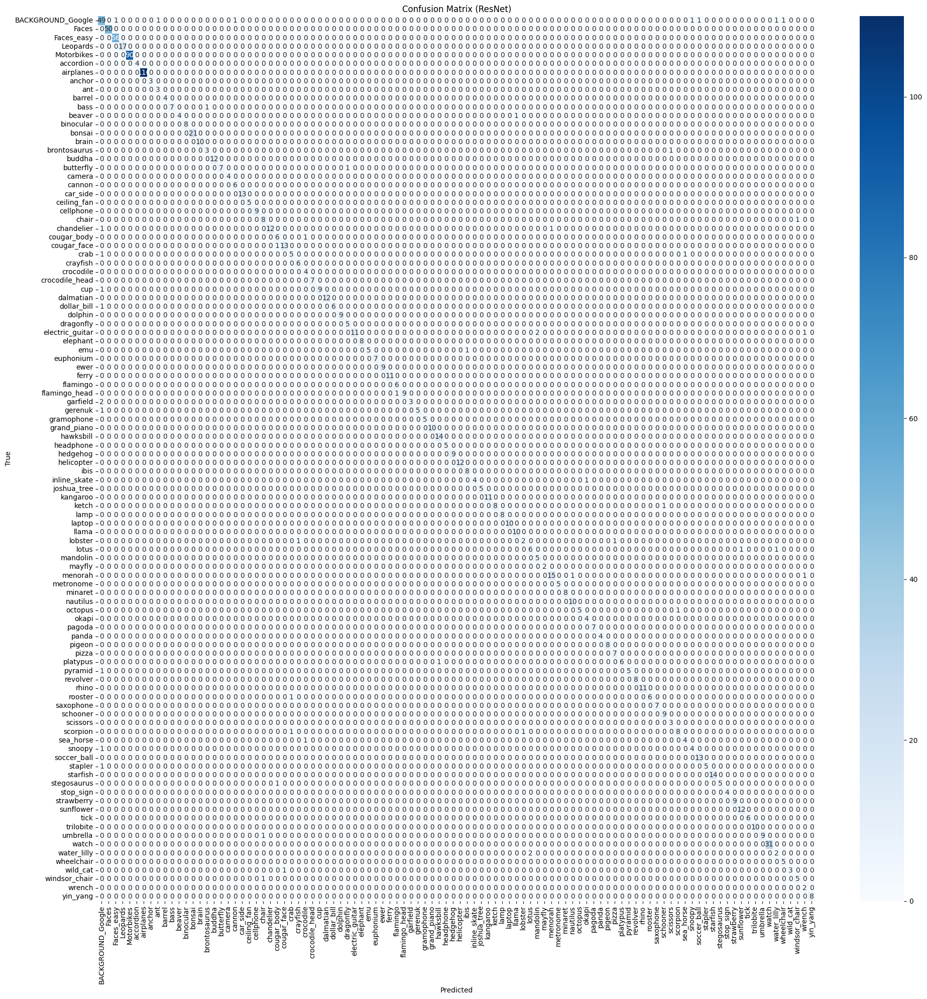

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import numpy as np

# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html

#Vorhersagen und wahre Labels sammeln
y_true = []
y_pred = []

for images, labels in test_data:
    preds = model_finetuned_pretrained_resnet.predict(images, verbose=0)
    preds_classes = np.argmax(preds, axis=1)
    y_true.extend(labels.numpy())
    y_pred.extend(preds_classes)

#Confusion Matrix berechnen
cm = confusion_matrix(y_true, y_pred)

#Visualisierung mit seaborn
plt.figure(figsize=(20, 20))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=dataset.class_names,
            yticklabels=dataset.class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix (ResNet)')
plt.tight_layout()
plt.show()

### Tensorboard Learning Curve

In [ ]:
%tensorboard --logdir logs/fit3

<IPython.core.display.Javascript object>

#### pictures

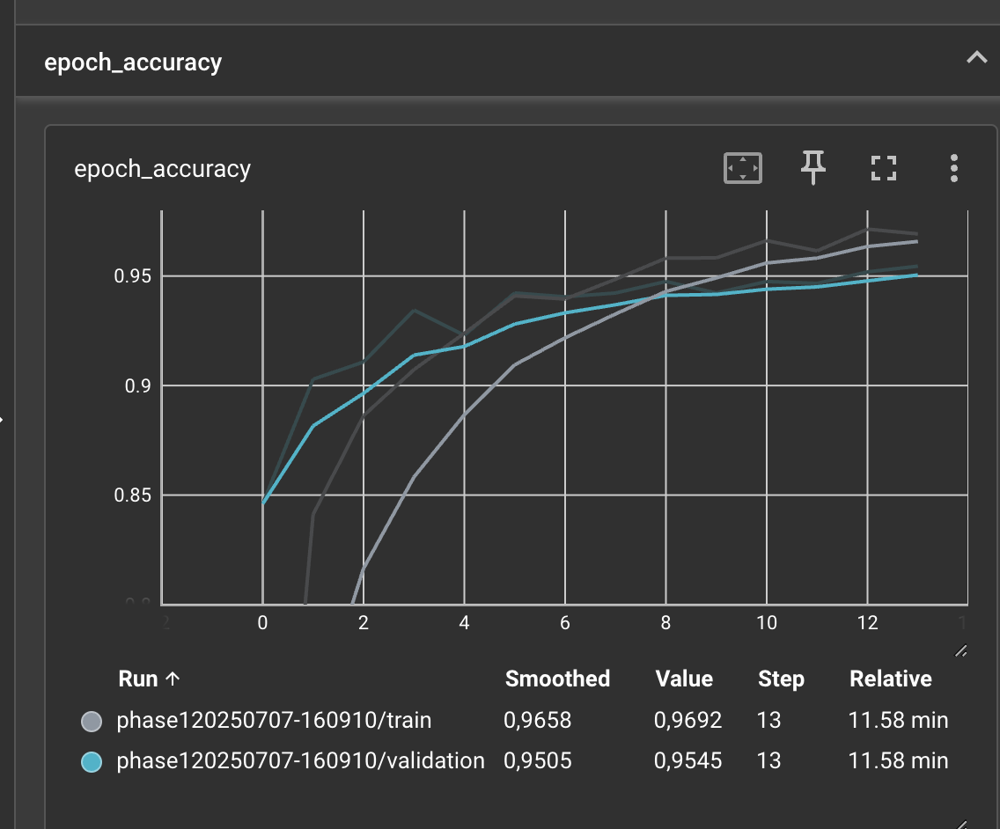

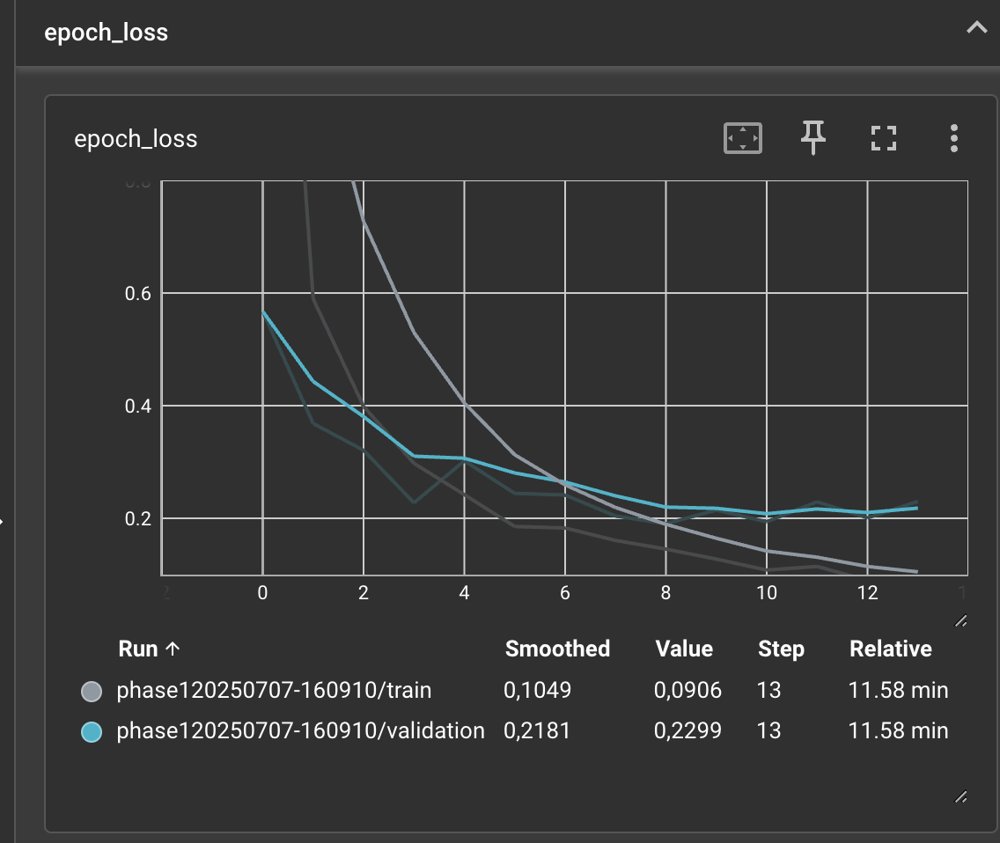

### ROC PLOT

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 

/tmp/ipython-input-12-4057699246.py:24: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab20', n_classes)  # bis zu 20 Farben
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_ranking.py:1188: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


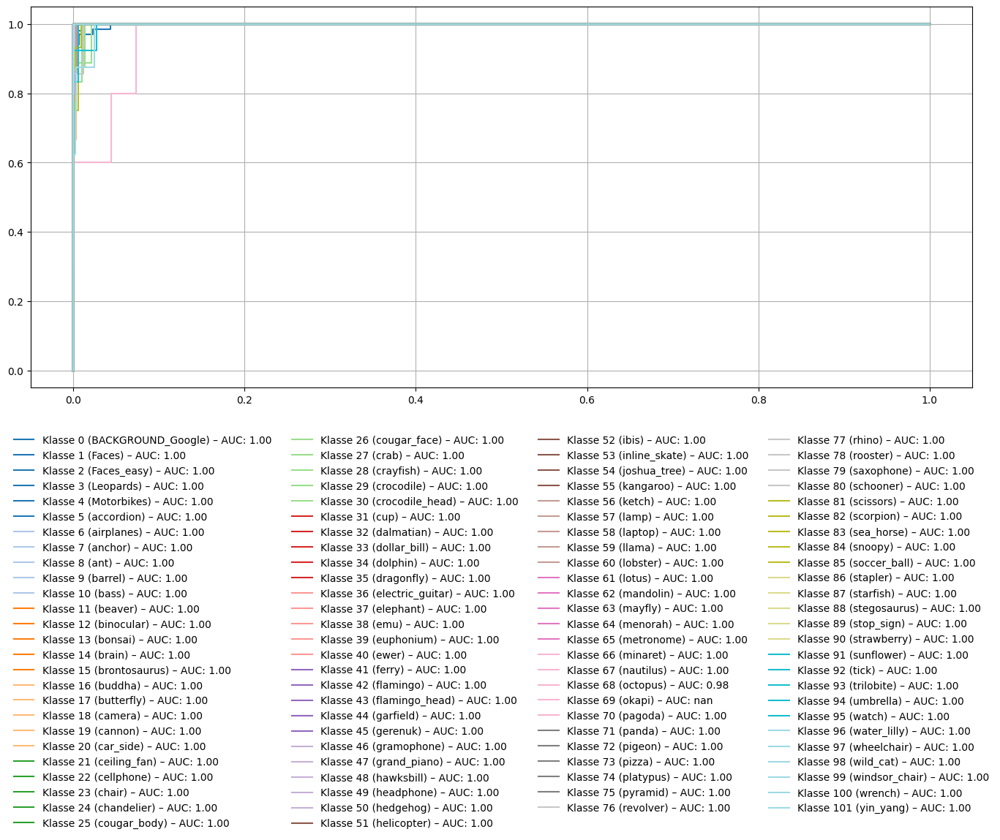

In [ ]:
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc

#Labels und vorhergesagte Wahrscheinlichkeiten sammeln

y_true = []
y_proba = []

for images, labels in test_data:
    probs = model_finetuned_pretrained_resnet.predict(images)
    y_proba.append(probs)
    y_true.extend(labels.numpy())

y_true = np.array(y_true)
y_pred_proba = np.vstack(y_proba)

# One-hot-encode die wahren Labels
n_classes = y_pred_proba.shape[1]
y_true_bin = label_binarize(y_true, classes=np.arange(n_classes))

#Plot ROC für jede Klasse
plt.figure(figsize=(15, 12))
colors = plt.cm.get_cmap('tab20', n_classes)

for i in range(n_classes):
    fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_pred_proba[:, i])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'Klasse {i} ({dataset.class_names[i]}) – AUC: {roc_auc:.2f}', color=colors(i))

# Legende unterhalb des Plots
plt.legend(loc='upper center',
           bbox_to_anchor=(0.5, -0.1),
           ncol=4,
           frameon=False)

plt.grid(True)
plt.tight_layout()
plt.show()


### PRC PLOT

36/36 ━━━━━━━━━━━━━━━━━━━━ 19s 219ms/step


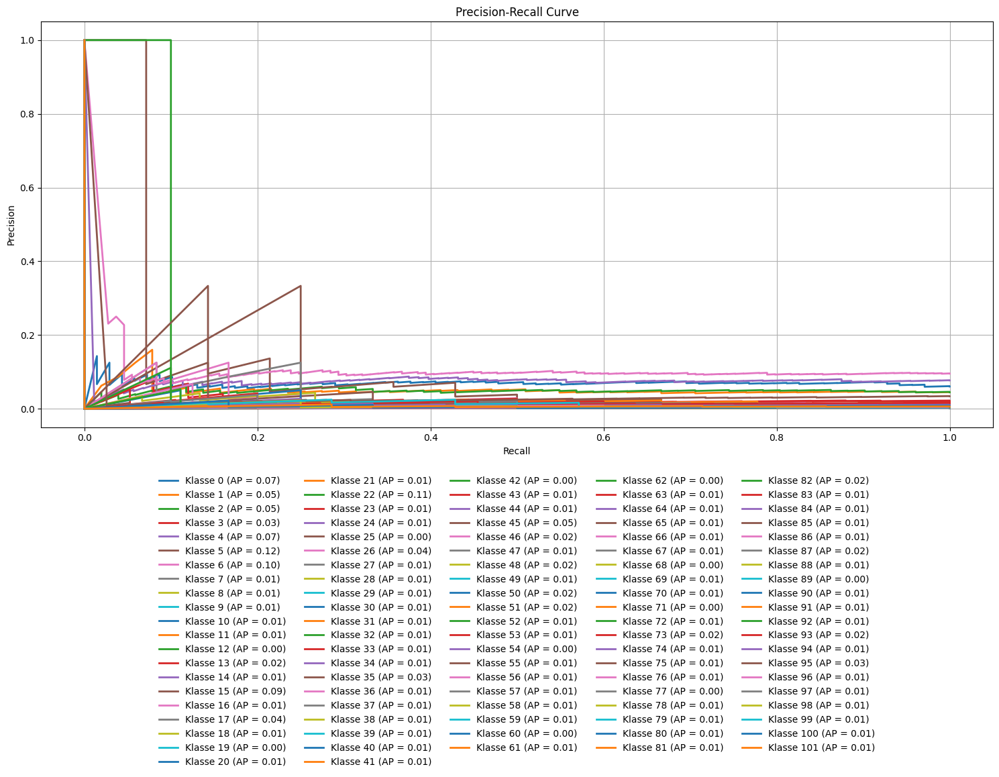

In [ ]:
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.preprocessing import label_binarize
import matplotlib.pyplot as plt

from sklearn.metrics import precision_recall_curve

import matplotlib.pyplot as plt

# src: https://stackoverflow.com/questions/56090541/how-to-plot-precision-and-recall-of-multiclass-classifier


#auc pcr curve für 3 layer cnn

y_score = model_finetuned_pretrained_resnet.predict(test_data)

#Labels aus dem test_data Dataset extrahieren
y_test = np.concatenate([y.numpy() for x, y in test_data], axis=0)

#Labels binarisieren (One-vs-Rest) für Multiklassen-PR-Kurve
n_classes = len(dataset.class_names)
y_test_bin = label_binarize(y_test, classes=list(range(n_classes)))

precision = dict()
recall = dict()
average_precision = dict()

plt.figure(figsize=(15, 12))
for i in range(n_classes):
    precision[i], recall[i], _ = precision_recall_curve(y_test_bin[:, i], y_score[:, i])
    ap_score = average_precision_score(y_test_bin[:, i], y_score[:, i])
    plt.plot(recall[i], precision[i], lw=2, label=f'Klasse {i} (AP = {ap_score:.2f})')


plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
# Legende unter dem Diagramm
plt.legend(loc='upper center',
           bbox_to_anchor=(0.5, -0.1),
           ncol=5,
           frameon=False)
plt.grid(True)
plt.tight_layout()
plt.show()


### TOP 1 Error Rate

In [ ]:
from sklearn.metrics import top_k_accuracy_score

# Wahre Labels und Vorhersagewahrscheinlichkeiten sammeln
y_true = []
y_score = []

for images, labels in test_data:
    probs = model_finetuned_pretrained_resnet.predict(images)
    y_score.extend(probs)
    y_true.extend(labels.numpy())

y_true = np.array(y_true)
y_score = np.array(y_score)

# Top-1 Accuracy
top1_acc = top_k_accuracy_score(y_true, y_score, k=1)

# Top-1 Error Rate
top1_error = 1 - top1_acc

print(f"Top-1 Accuracy: {top1_acc * 100:.2f}%")
print(f"Top-1 Error Rate: {top1_error * 100:.2f}%")



2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Top-1 Accuracy: 95.28%
Top-1 Error Rate: 4.72%


Explain the results:

a) What kind of features did filters extract?
b) Do you have "blind" filters that didn't learn anything? Why? How could you fix that?
c) Does your model consider the background of the inputs?
d) Does your model consider the color of the inputs?
